In [1]:
import matplotlib.pyplot as plt
import numpy as np
import glob
import os
import sys
import time
import datetime as dt
import pandas as pd
import geopandas as gpd
import scipy as sp
from scipy import signal
from tqdm.notebook import tqdm
import rasterio as rio
from shapely.geometry import Point, LineString, Polygon, MultiPoint
import fiona
from shapely.ops import nearest_points

In [2]:
!pwd

/Users/home/whitefar/DATA/Jupyter/REMA


In [40]:
x_interpd = np.load('/Users/home/whitefar/DATA/FIELD_ANT_19/POST_FIELD/RADAR_MAP/channel_line2line_interpbydist_points_x.npy')
y_interpd = np.load('/Users/home/whitefar/DATA/FIELD_ANT_19/POST_FIELD/RADAR_MAP/channel_line2line_interpbydist_points_y.npy')
it_interpd = np.load('/Users/home/whitefar/DATA/FIELD_ANT_19/POST_FIELD/RADAR_MAP/channel_line2line_interpbydist_ice_thickn.npy')
ib_interpd = np.load('/Users/home/whitefar/DATA/FIELD_ANT_19/POST_FIELD/RADAR_MAP/channel_line2line_interpbydist_icebase.npy')

FileNotFoundError: [Errno 2] No such file or directory: '/Users/home/whitefar/DATA/FIELD_ANT_19/POST_FIELD/RADAR_MAP/channel_line2line_interpbydist_points_x.npy'

In [4]:
#load REMA
nid1 = 159202
nid2 = 131226
df = gpd.read_file('/Volumes/arc_02/whitefar/DATA/REMOTE_SENSING/REMA_STRIPES/REMA_Strip_Index_Rel1/REMA_Strip_Index_Rel1.shp')

In [5]:
path = f"/Volumes/arc_02/whitefar/DATA/REMOTE_SENSING/REMA_STRIPES/DIFFERENCES/REMA_159202-131226_diff.tif"
f = df.loc[nid1].acquisitio
t =df.loc[nid2].acquisitio

In [6]:
df.loc[nid2].fileurl

'http://data.pgc.umn.edu/elev/dem/setsm/REMA/geocell/v1.0/2m/s83w153/SETSM_WV01_20161109_1020010058134D00_10200100576C9100_seg1_2m_v1.0.tar.gz'

In [7]:
duration = (pd.to_datetime(t)-pd.to_datetime(f)).days/365.25
with rio.open(path) as image:
    im = image.read(1)
    im = im / duration
#     im[im==-9999] = np.nan
    extent_REMAdiff = [image.bounds[0],image.bounds[2],image.bounds[1],image.bounds[3]]
    left = image.bounds[0]
    bottom = image.bounds[1]
    right = image.bounds[2]    
    top = image.bounds[3]
    

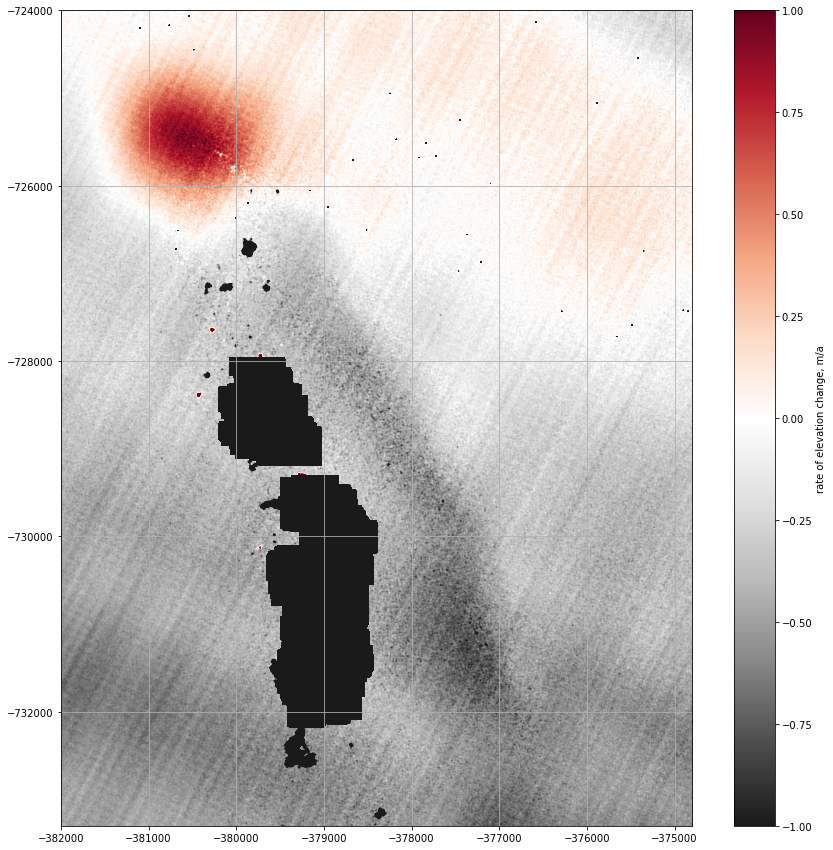

In [8]:
plt.figure(figsize=(15,15))
GyRd = plt.cm.get_cmap('RdGy').reversed()
plt.imshow(im,extent=extent_REMAdiff, vmin=-1,vmax=1,cmap=GyRd)
cb = plt.colorbar()
cb.set_label('rate of elevation change, m/a')
plt.xlim([-382000, -374800])
plt.ylim([-733300,-724000])
plt.grid()
plt.show()

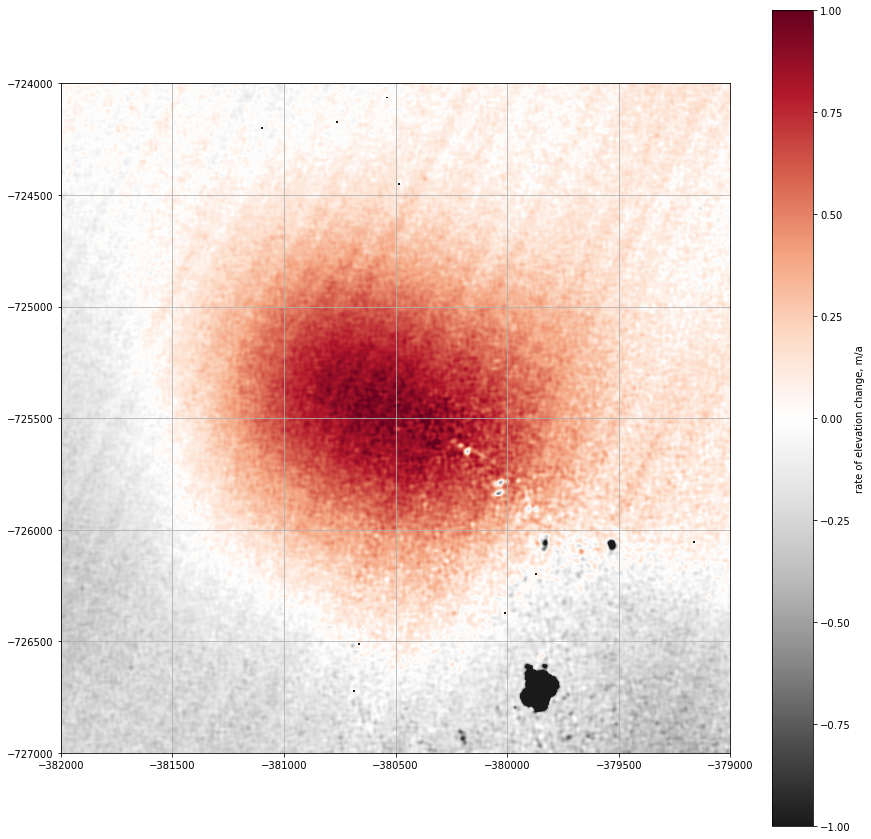

In [9]:
plt.figure(figsize=(15,15))
GyRd = plt.cm.get_cmap('RdGy').reversed()
plt.imshow(im,extent=extent_REMAdiff, vmin=-1,vmax=1,cmap=GyRd)
cb = plt.colorbar()
cb.set_label('rate of elevation change, m/a')
plt.xlim([-382000, -379000])
plt.ylim([-727000,-724000])
plt.grid()
plt.show()

convex hull

1. get xv and yv values from raster
2. make 3D array of [elevation change, xv, yv]
3. restrict array to > 0.75
4. multiply elevation change by pixel size

In [10]:
# figuring out indexing

# aa = np.array([np.arange(0,12).reshape(3,4),np.arange(0,12).reshape(3,4)+0.1,np.arange(0,12).reshape(3,4)+0.2])
# aa
# aa[:,aa[1,:]>3.1].reshape(3,2,4)

In [11]:
#1. get sv and yv values from raster
x = np.linspace(left,right, im.shape[1])
y = np.linspace(top,bottom, im.shape[0])
xv, yv = np.meshgrid(x ,y ) 
print(xv.shape,yv.shape,im.shape)

(20089, 19985) (20089, 19985) (20089, 19985)


In [12]:
# 2. make 3D array of [elevation change, xv, yv]
elevs = np.array([xv,yv,im])
elevs.shape

(3, 20089, 19985)

In [13]:
#reduce the array to elevation change above 0.7 and to the area over the bullseye
elevs_red = elevs[:,(elevs[2,:]>0.72) & (elevs[0,:]> -382000) & (elevs[0,:]<-379000) & (elevs[1,:] > -727000)  & (elevs[1,:] < -724000)] 
elevs_red_area = elevs[:,(elevs[0,:]> -382000) & (elevs[0,:]<-379000) & (elevs[1,:] > -727000)  & (elevs[1,:] < -724000)] 

In [14]:
elevs_red.shape

(3, 115370)

In [15]:
# del elevs, xv, yv, im

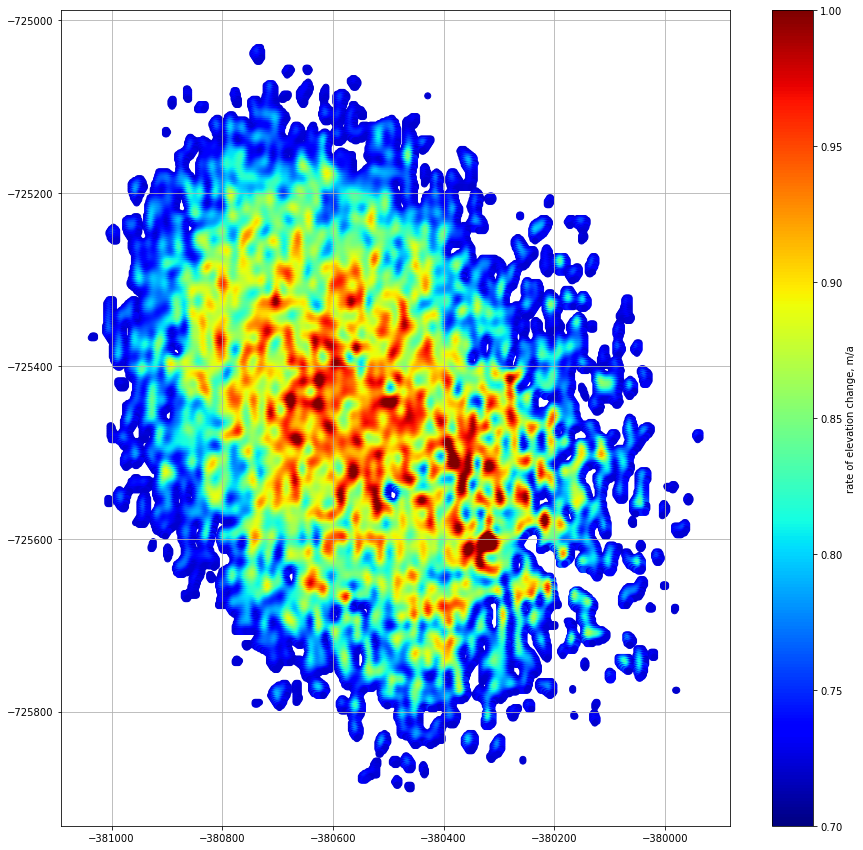

In [16]:
plt.figure(figsize=(15,15))
GyRd = plt.cm.get_cmap('RdGy').reversed()
plt.scatter(elevs_red[0,:],elevs_red[1,:],c=elevs_red[2,:],vmin=0.7,vmax=1,cmap='jet')
cb = plt.colorbar()
cb.set_label('rate of elevation change, m/a')
# plt.xlim([-382000, -374800])
# plt.ylim([-733300,-724000])
plt.grid()
plt.show()

In [17]:
dx = np.median(np.diff(x))
dy = np.median(-np.diff(y))
pixel = dx*dy
pixel

4.000399293796096

In [20]:
print(elevs_red.max(),elevs_red.min())

1.2909752130508423 -725889.31043409


(array([3.2927e+04, 2.9324e+04, 2.8775e+04, 1.8228e+04, 5.4970e+03,
        5.0800e+02, 4.2000e+01, 2.7000e+01, 2.2000e+01, 2.0000e+01]),
 array([0.72000307, 0.77710028, 0.8341975 , 0.89129471, 0.94839193,
        1.00548914, 1.06258636, 1.11968357, 1.17678078, 1.233878  ,
        1.29097521]),
 <BarContainer object of 10 artists>)

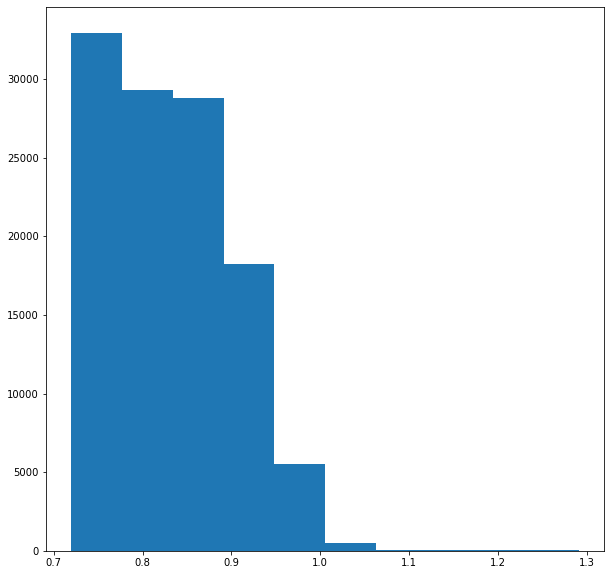

In [21]:
plt.figure(figsize=(10,10))
plt.hist(elevs_red[2,:])


(array([3.2927e+04, 2.9324e+04, 2.8775e+04, 1.8228e+04, 5.4970e+03,
        5.0800e+02, 4.2000e+01, 2.7000e+01, 2.2000e+01, 2.0000e+01]),
 array([0.72000307, 0.77710028, 0.8341975 , 0.89129471, 0.94839193,
        1.00548914, 1.06258636, 1.11968357, 1.17678078, 1.233878  ,
        1.29097521]),
 <BarContainer object of 10 artists>)

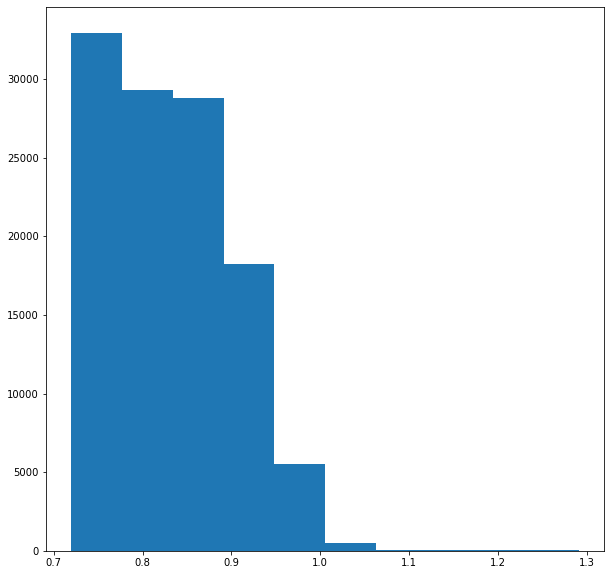

In [20]:
plt.figure(figsize=(10,10))
plt.hist(elevs_red[2,:])


(array([1.1370e+04, 1.1059e+04, 1.0498e+04, 1.0293e+04, 9.6020e+03,
        9.4290e+03, 9.7490e+03, 9.6890e+03, 9.3370e+03, 7.6380e+03,
        5.9480e+03, 4.6420e+03, 3.2490e+03, 1.5590e+03, 6.8900e+02,
        3.3300e+02, 1.3300e+02, 4.2000e+01, 2.3000e+01, 1.0000e+01,
        9.0000e+00, 1.5000e+01, 3.0000e+00, 9.0000e+00, 7.0000e+00,
        1.0000e+01, 5.0000e+00, 7.0000e+00, 7.0000e+00, 6.0000e+00]),
 array([0.72000307, 0.73903547, 0.75806788, 0.77710028, 0.79613269,
        0.81516509, 0.8341975 , 0.8532299 , 0.87226231, 0.89129471,
        0.91032712, 0.92935952, 0.94839193, 0.96742433, 0.98645674,
        1.00548914, 1.02452155, 1.04355395, 1.06258636, 1.08161876,
        1.10065116, 1.11968357, 1.13871597, 1.15774838, 1.17678078,
        1.19581319, 1.21484559, 1.233878  , 1.2529104 , 1.27194281,
        1.29097521]),
 <BarContainer object of 30 artists>)

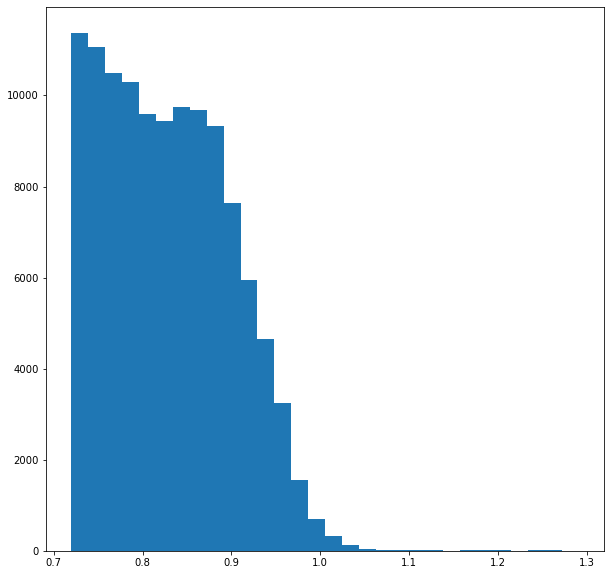

In [21]:
plt.figure(figsize=(10,10))
plt.hist(elevs_red[2,:],30)


In [22]:
print('median melt rate = ',np.median(elevs_red[2,:]))

median melt rate =  0.8248015642166138


In [27]:
print('mean melt rate = ',np.mean(elevs_red[2,:]))

mean melt rate =  0.8296496367024685


In [24]:
# 4. multiply elevation change by pixel size
mass_loss = np.sum(elevs_red[2,:])*pixel
print(mass_loss,' m^3 / a of ice downwasted')

382904.9334213976  m^3 / a of ice downwasted


### Next see how much melt would need in channel

1. make a polygon of downwasting
2. make a polygon of channel
3. get intersection
4. see downwasting rate in intersection

In [25]:
# 1. make a polygon of downwasting
bullseye_mp = MultiPoint( [(x,y) for x,y in zip(elevs_red[0,:],elevs_red[1,:])])
bullseye_mp

In [26]:
bullseye = bullseye_mp.convex_hull


In [28]:
# import pickle
# with open('/Users/home/whitefar/DATA/FIELD_ANT_19/POST_FIELD/shapefiles/bullseye.pkl', "wb") as poly_file:
#     pickle.dump(bullseye, poly_file, pickle.HIGHEST_PROTOCOL)

get all points from in the shape

In [29]:
df = pd.DataFrame({'x': elevs_red_area[0,:],
                        'y': elevs_red_area[1,:],
                        'dzdt':elevs_red_area[2,:]})

In [30]:
del elevs_red, bullseye_mp, elevs_red_area

In [31]:
geometry = [Point(xy) for xy in zip(df.x,df.y)]
gdf= gpd.GeoDataFrame(df,geometry=geometry,crs="EPSG:3031")

In [32]:
gdf['in_bullseye'] = gdf.geometry.intersects(bullseye)

In [34]:
#ThIS IS THE GOOD ONE TO USE - VOLUME DOWNWASTED
volume_loss = gdf[gdf['in_bullseye']==True].dzdt.sum()*pixel
print(volume_loss)

531826.1556926586


In [35]:
bullseye.area

689118.7833735817

In [37]:
# bullseye.area*np.mean(elevs_red[2,:])

In [38]:
382904

382904

In [39]:
# 2. make a polygon of channel
chan_right =  [(x,y) for x,y in zip(x_interpd[0,::-1],y_interpd[0,::-1])]
chan_left =  [(x,y) for x,y in zip(x_interpd[-1,:],y_interpd[-1,:])]
chan_beg = [(x,y) for x,y in zip(x_interpd[:,0],y_interpd[:,0])]
chan_end = [(x,y) for x,y in zip(x_interpd[::-1,-1],y_interpd[::-1,-1])]

NameError: name 'x_interpd' is not defined

In [ ]:
chan = Polygon(chan_left+chan_end+chan_right+chan_beg)

In [ ]:
chan

In [ ]:
# 3. get intersection
melt_under = chan.intersection(bullseye)
melt_under

In [ ]:
# 4. see downwasting rate in intersection

In [ ]:
print("melt rate in 1D m / a underneath  = ",volume_loss / melt_under.area)

In [ ]:
X0a = Point(x_interpd[0,0],y_interpd[0,0])
X0b = Point(x_interpd[-1,0],y_interpd[-1,0])

print('width of channel is ',X0a.distance(X0b),'m')